In [2]:
import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt
import re
import pickle

In [3]:
# Load Myntra dataset
myntra = pd.read_csv('myntra_excel.csv')

In [4]:
myntra.shape

(15000, 26)

In [5]:
# Remove duplicate entries based on title from myntra
myntra  = myntra.drop_duplicates(subset=['title'])
myntra.shape

(11250, 26)

In [6]:
myntra

,uniq_id,crawl_timestamp,product_id,link,size,variant_sku,brand,care_instructions,dominant_material,title,...,size_fit,complete_the_look,type,variant_price,variant_compare_at_price,ideal_for,is_in_stock,inventory,specifications,Unnamed: 25
0,cc51c3dd925d9d84e2fb28c7918dbbc3,2019-08-11 05:49:46 +0000,6937673,https://www.myntra.com/tops/imara/imara-women-...,XL,6937673_XL,IMARA,Polyester | Dry-clean,Polyester,IMARA Women Black Solid Top,...,"The model (height 5'8"") is wearing a size S",Improve your personal style with a brand new t...,Clothing/Women/Tops/IMARA/More by IMARA,959,1599,Women,Out of Stock,0,Transparency : Opaque | Sleeve Styling : Bell ...,NaN
1,c7e2fe388a93dae5c86b50dd8a5dbd7a,2019-07-03 01:04:34 +0000,7441182,https://www.myntra.com/kurtas/house-of-pataudi...,XL,7441182_XL,House of Pataudi,100% cottonMachine-wash,cotton,House of Pataudi Men Black Printed Straight Kurta,...,The model (height 6') is wearing a size M,"From House of Pataudi, this kurta is a great w...",Clothing/Men/Kurtas/House of Pataudi/More by H...,799,1999,Men,In Stock,Shape : Straight | Sleeve Styling : Regular Sl...,NaN,NaN
2,76949d78057a633aace6246045eefd66,2019-07-15 09:43:31 +0000,9245141,https://www.myntra.com/pillows/the-white-willo...,S,9245141_S,The White Willow,Polycotton | Only spot clean by hand with warm...,Cotton,The White Willow Unisex Off-White Therapedic M...,...,Dimensions: 58.42 cm x 33.02 cm x 10.16 cm,The White Willow has been founded with the vis...,Home/Unisex/Pillows/The White Willow/More by T...,1399,2799,Unisex,In Stock,Number of Components : 1 | Material : Polycott...,NaN,NaN
3,5f83f6b51da1ef93bc0585577b6991e6,2019-07-15 14:11:14 +0000,1314889,https://www.myntra.com/dupatta/dupatta-bazaar/...,Onesize,1314889_Onesize,Dupatta Bazaar,Chiffon | Hand-wash,Chiffon,Dupatta Bazaar Pink Dupatta,...,Length: 2.3 metres Width: 1.1 metres,Complement your ethnic ensemble with this dupa...,Clothing/Women/Dupatta/Dupatta Bazaar/More by ...,349,499,Women,In Stock,Pattern : Solid | Occasion : Daily | Border : ...,NaN,NaN
4,890bf4355c319a4211296b9d3176d11f,2019-06-01 08:17:28 +0000,7705322,https://www.myntra.com/kurta-sets/manyavar/man...,S,7705322_S,Manyavar,Top fabric: Silk Blend | Bottom fabric: Silk B...,Silk,Manyavar Men Yellow & White Self Design Kurta ...,...,The model (height 6') is wearing a size M,"From Manyavar, this kurta is a great way to sh...",Clothing/Men/Kurta Sets/Manyavar/More by Manyavar,2999,2999,Men,Out of Stock,Occasion : Festive | Number of Components : 2 ...,NaN,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
14993,65cd8b64bac9149ae6376fc9f0291b85,2019-08-19 03:44:04 +0000,2366741,https://www.myntra.com/2366741,M,2366741_M,Shree,100% LivaHand-wash,Liva,Shree Women Grey & Red Floral Print Maxi Dress,...,"Semi-Fit The model (height 5'8"") is wearing a...",This timeless and sumptuous Shree dress is sui...,Clothing/Women/Dresses/Shree/More by Shree,764,1699,Women,Out of Stock,0,Knit or Woven : Woven | Transparency : Opaque ...,NaN
14994,fa6d9090467edc3dc0706e6c66707bd1,2019-08-19 07:01:59 +0000,6554346,https://www.myntra.com/6554346,XL,6554346_XL,Freehand,Top fabric: Pure Cotton | Bottom fabric: Pure ...,Cotton,Freehand Men Red & White Self-Design Kurta wit...,...,The model (height 6') is wearing a size M,This in-style kurta from Freehand is a must-ha...,Clothing/Men/Kurta Sets/Freehand/More by Freehand,919,2299,Men,Out of Stock,0,Occasion : Daily | Number of Components : 2 | ...,NaN
14996,d42876ac4e79f4f8eafce06f42b83c4e,2019-08-19 15:55:34 +0000,5504617,https://www.myntra.com/kurtas/shakumbhari/shak...,XXL,5504617_XXL,Shakumbhari,Cotton | Machine-wash,Cotton,Shakumbhari Women Pink Embroidered A-Line Kurta,...,"The model (height 5'8"") is wearing a size S",Make a statement with this elegant kurta from ...,Clothing/Women/Kurtas/Shakumbhari/More by Shak...,627,1395,Women,Out of Stock,0,Shape : A-Line | Business Unit : Apparel | Sle...,https://www.myntra.com/shakumbhari
14997,b

In [7]:
# After removing duplicate values, Reset index of database
myntra.reset_index(drop=True, inplace = True)

In [8]:
# All the features of the dataset
features = myntra.columns
print(features)

Index(['uniq_id', 'crawl_timestamp', 'product_id', 'link', 'size',
       'variant_sku', 'brand', 'care_instructions', 'dominant_material',
       'title', 'actual_color', 'dominant_color', 'product_type', 'images',
       'body', 'product_details', 'size_fit', 'complete_the_look', 'type',
       'variant_price', 'variant_compare_at_price', 'ideal_for', 'is_in_stock',
       'inventory', 'specifications', 'Unnamed: 25'],
      dtype='object')


In [9]:
# To check if the dataset has any null values or not
myntra.isnull().sum()

uniq_id                         0
crawl_timestamp                 0
product_id                      0
link                            0
size                            0
variant_sku                     0
brand                           0
care_instructions              20
dominant_material             431
title                           0
actual_color                  784
dominant_color                790
product_type                 1200
images                          0
body                            0
product_details                 0
size_fit                     1007
complete_the_look             176
type                            0
variant_price                   0
variant_compare_at_price        0
ideal_for                       0
is_in_stock                     0
inventory                      93
specifications               4327
Unnamed: 25                 10812
dtype: int64

In [10]:
# First row
myntra.loc[0]

uniq_id                                      cc51c3dd925d9d84e2fb28c7918dbbc3
crawl_timestamp                                     2019-08-11 05:49:46 +0000
product_id                                                            6937673
link                        https://www.myntra.com/tops/imara/imara-women-...
size                                                                       XL
variant_sku                                                        6937673_XL
brand                                                                   IMARA
care_instructions                                       Polyester | Dry-clean
dominant_material                                                   Polyester
title                                             IMARA Women Black Solid Top
actual_color                                                            Black
dominant_color                                                          Black
product_type                                                    

In [11]:
myntra['product_id'].value_counts()

product_id
9196975    2
9539307    2
9792639    2
2322993    1
5618531    1
          ..
6824698    1
9792743    1
7233560    1
8034229    1
7502286    1
Name: count, Length: 11247, dtype: int64

In [12]:
# Drop duplicate products based on product_id
myntra = myntra.drop_duplicates(subset = ["product_id"])
myntra.shape

(11247, 26)

In [13]:
# No duplicate entries available based on product_id
myntra['product_id'].value_counts()

product_id
2012151    1
6937673    1
7441182    1
9245141    1
1314889    1
          ..
9038627    1
9088553    1
7217185    1
8991019    1
8665021    1
Name: count, Length: 11247, dtype: int64

In [14]:

myntra['ideal_for'].value_counts()

ideal_for
Women     7000
Men       2741
Unisex     546
Girls      534
Boys       426
Name: count, dtype: int64

<Axes: xlabel='ideal_for', ylabel='count'>

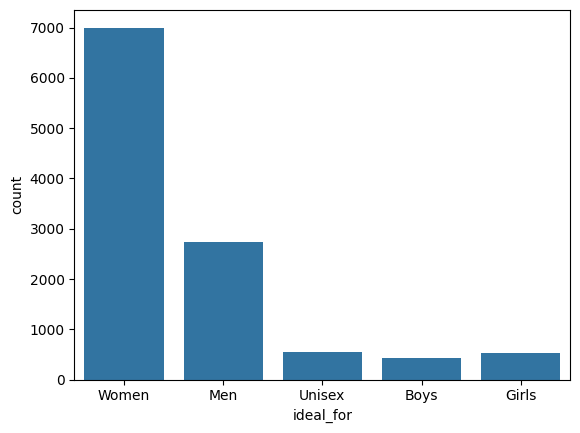

In [15]:
sns.countplot(x = 'ideal_for', data = myntra)

In [16]:
myntra['brand'].value_counts()

brand
Anouk           1158
Biba             832
Libas            607
Shree            560
Global Desi      523
                ... 
Toss Winner        1
Khushal K          1
Just Wow           1
American Eye       1
AASK               1
Name: count, Length: 364, dtype: int64

<Axes: xlabel='brand'>

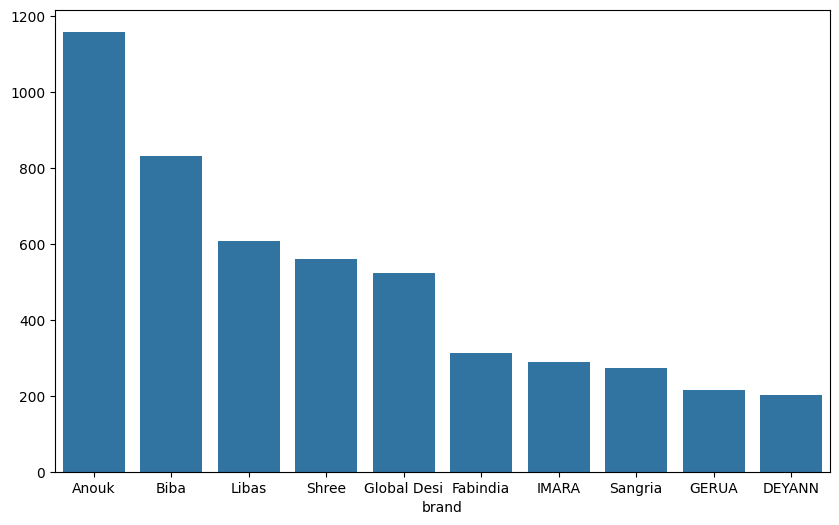

In [17]:
# Top 10 brands bard plot
plt.figure(figsize=(10,6))
sns.barplot(x = myntra['brand'].value_counts().index[0:10] , y = myntra['brand'].value_counts().values[0:10] )

In [18]:
Top_Brands = dict(myntra['brand'].value_counts()[0: 20])
print(Top_Brands)

{'Anouk': np.int64(1158), 'Biba': np.int64(832), 'Libas': np.int64(607), 'Shree': np.int64(560), 'Global Desi': np.int64(523), 'Fabindia': np.int64(312), 'IMARA': np.int64(288), 'Sangria': np.int64(272), 'GERUA': np.int64(214), 'DEYANN': np.int64(202), 'AKS': np.int64(200), 'SOJANYA': np.int64(182), 'Rangriti': np.int64(180), 'Inddus': np.int64(176), 'INDYA': np.int64(174), 'KISAH': np.int64(154), 'VASTRAMAY': np.int64(154), 'even': np.int64(140), 'Freehand': np.int64(128), 'Aj DEZInES': np.int64(128)}


In [19]:
myntra['inventory'][0]

'0'

In [20]:
myntra['inventory'][1]

'Shape : Straight | Sleeve Styling : Regular Sleeves | Occasion : Daily | Print or Pattern Type : Geometric | Number of Components : 1 | Design Styling : Regular | Colour Family : Monochrome | Neck : Mandarin Collar | Pattern : Printed | Body or Garment Size : Garment Measurements in | Sleeve Length : Long Sleeves | Weave Pattern : Regular | Fabric Purity : Pure | Stitch : Ready to Wear | Hemline : Straight | Wash Care : Machine Wash | Weave Type : Machine Weave | Length : Knee Length | Slit Detail : Side Slits | Fabric : Cotton'

In [21]:
# Firstly Fill every null values with ""
myntra['inventory'].fillna("", inplace = True)

# If string has length less than 2 = replace it with " " in inventory
def updateInventory(x):
    if(len(x) < 2):
        x = " "
    return x
myntra['inventory'] = myntra['inventory'].apply(updateInventory)


myntra['inventory']


C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\3705278221.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  myntra['inventory'].fillna("", inplace = True)
C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\3705278221.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['inventory'].fillna("", inplace = True)
C:\Users\lenovo\AppData\L

0                                                         
1        Shape : Straight | Sleeve Styling : Regular Sl...
2        Number of Components : 1 | Material : Polycott...
3        Pattern : Solid | Occasion : Daily | Border : ...
4        Occasion : Festive | Number of Components : 2 ...
                               ...                        
11245                                                     
11246                                                     
11247                                                     
11248                                                     
11249                                                     
Name: inventory, Length: 11247, dtype: object

In [22]:

# Split the string and then replace all numvers and regular expressions with " " and return preprocessed string which can bes used in model training
def preprocessInventory(x):

    ls = x.split(" | ")

    str = " ".join(ls)
    cleanString = re.sub('\W+',' ', str ).strip()
 
    return cleanString.lower()


myntra['Pre_Inventory'] = myntra['inventory'].apply(preprocessInventory)

myntra['Pre_Inventory']

C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\3643888686.py:12: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['Pre_Inventory'] = myntra['inventory'].apply(preprocessInventory)


0                                                         
1        shape straight sleeve styling regular sleeves ...
2        number of components 1 material polycotton set...
3                pattern solid occasion daily border solid
4        occasion festive number of components 2 top pa...
                               ...                        
11245                                                     
11246                                                     
11247                                                     
11248                                                     
11249                                                     
Name: Pre_Inventory, Length: 11247, dtype: object

In [23]:
myntra['type'][0]

'Clothing/Women/Tops/IMARA/More by IMARA'

In [24]:
# for getting all values separated by "/" and use it into model
def preprocessType(x):
    ls = x.split("/")
    str = ' '.join(ls).strip()
    return str.lower()


myntra['type'] = myntra['type'].apply(preprocessType)

C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\770083449.py:8: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['type'] = myntra['type'].apply(preprocessType)


In [25]:
myntra['type'][0: 5]

0              clothing women tops imara more by imara
1    clothing men kurtas house of pataudi more by h...
2    home unisex pillows the white willow more by t...
3    clothing women dupatta dupatta bazaar more by ...
4    clothing men kurta sets manyavar more by manyavar
Name: type, dtype: object

In [26]:
myntra['body'][1]

"Black printed straight kurta, has a mandarin collar, long sleeves, straight hem, side slits and two pockets\r\nThe model (height 6') is wearing a size M\r\nFrom House of Pataudi, this kurta is a great way to show off your style.  Dress this black piece up with your favourite accessories and head out to any family event in style.\r\n100% cottonMachine-wash"

In [27]:
# Remove numbers and regular expressions from the string and preprocess it

def preproceBody(X):
    
    
    cleanString = re.sub(r"[^A-Za-z]+",' ', X )
    
    return cleanString.lower()

myntra['preprocess_body'] = myntra['body'].apply(preproceBody)
myntra['preprocess_body'][0]

C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\1709789841.py:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['preprocess_body'] = myntra['body'].apply(preproceBody)


'black solid woven regular top has a v neck three quarter sleeves an attached lining the model height is wearing a size s improve your personal style with a brand new three quarter sleeve top designed by imara when you want to have the perfect outfit for a fun lunch with the girls you ll want to put this black piece with an ankle boot and tapered leg pants polyester dry clean'

In [28]:
# Fill evenry null values with ""
myntra['care_instructions'].fillna("", inplace=True )
myntra['care_instructions'].isnull().sum()


C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\1704744692.py:2: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  myntra['care_instructions'].fillna("", inplace=True )
C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\1704744692.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['care_instructions'].fillna("", inplace=True )


np.int64(0)

In [29]:
myntra['dominant_material'].fillna('', inplace = True)
myntra['dominant_color'].fillna("", inplace=True)
myntra['actual_color'].fillna("", inplace=True)
print(myntra['dominant_material'].isnull().sum())
print(myntra['dominant_color'].isnull().sum())
print(myntra['actual_color'].isnull().sum())

0
0
0


C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\223798027.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  myntra['dominant_material'].fillna('', inplace = True)
C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\223798027.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['dominant_material'].fillna('', inplace = True)
C:\Users\le

In [30]:
# Multiple images are there so covert them into list
def image_process(x):
    x = x.split(" | ")

    return x

In [31]:

myntra['images'] = myntra['images'].apply(image_process)
myntra['images']

C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\1528754085.py:1: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra['images'] = myntra['images'].apply(image_process)


0        [http://assets.myntassets.com/v1/assets/images...
1        [http://assets.myntassets.com/v1/assets/images...
2        [http://assets.myntassets.com/v1/assets/images...
3        [http://assets.myntassets.com/v1/assets/images...
4        [http://assets.myntassets.com/v1/assets/images...
                               ...                        
11245    [http://assets.myntassets.com/v1/assets/images...
11246    [http://assets.myntassets.com/v1/assets/images...
11247    [http://assets.myntassets.com/v1/assets/images...
11248    [http://assets.myntassets.com/v1/assets/images...
11249    [http://assets.myntassets.com/v1/assets/images...
Name: images, Length: 11247, dtype: object

In [32]:
# remove all data with less than 4 images
myntra = myntra[myntra['images'].apply(lambda x : len(x) > 3)]

In [217]:
myntra['specifications'].fillna("" , inplace = True)

C:\Users\yjaye\AppData\Local\Temp\ipykernel_64528\2996349011.py:1: FutureWarning: A value is trying to be set on a copy of a DataFrame or Series through chained assignment using an inplace method.
The behavior will change in pandas 3.0. This inplace method will never work because the intermediate object on which we are setting values always behaves as a copy.

For example, when doing 'df[col].method(value, inplace=True)', try using 'df.method({col: value}, inplace=True)' or df[col] = df[col].method(value) instead, to perform the operation inplace on the original object.


  myntra['specifications'].fillna("" , inplace = True)


In [33]:
# Preprocessing 
def preprocessCareInstruction(x):
    x = x.replace(u'\xa0', u' ')
    x = x.replace('-', '')
    
    
    ls = x.split(" | ")

    str = " ".join(ls)
    cleanString = re.sub('\W+',' ', str ).strip()

    return cleanString.lower()


myntra['care_instructions'] = myntra['care_instructions'].apply(preprocessCareInstruction)

myntra['care_instructions'][12]

'top fabric tussar silk bottom fabric tussar silk handwash'

In [219]:
myntra.head()

,uniq_id,crawl_timestamp,product_id,link,size,variant_sku,brand,care_instructions,dominant_material,title,...,type,variant_price,variant_compare_at_price,ideal_for,is_in_stock,inventory,specifications,Unnamed: 25,Pre_Inventory,preprocess_body
0,cc51c3dd925d9d84e2fb28c7918dbbc3,2019-08-11 05:49:46 +0000,6937673,https://www.myntra.com/tops/imara/imara-women-...,XL,6937673_XL,IMARA,polyester dryclean,Polyester,IMARA Women Black Solid Top,...,clothing women tops imara more by imara,959,1599,Women,Out of Stock,,Transparency : Opaque | Sleeve Styling : Bell ...,NaN,,black solid woven regular top has a v neck thr...
1,c7e2fe388a93dae5c86b50dd8a5dbd7a,2019-07-03 01:04:34 +0000,7441182,https://www.myntra.com/kurtas/house-of-pataudi...,XL,7441182_XL,House of Pataudi,100 cottonmachinewash,cotton,House of Pataudi Men Black Printed Straight Kurta,...,clothing men kurtas house of pataudi more by h...,799,1999,Men,In Stock,Shape : Straight | Sleeve Styling : Regular Sl...,,NaN,shape straight sleeve styling regular sleeves ...,black printed straight kurta has a mandarin co...
2,76949d78057a633aace6246045eefd66,2019-07-15 09:43:31 +0000,9245141,https://www.myntra.com/pillows/the-white-willo...,S,9245141_S,The White Willow,polycotton only spot clean by hand with warm w...,Cotton,The White Willow Unisex Off-White Therapedic M...,...,home unisex pillows the white willow more by t...,1399,2799,Unisex,In Stock,Number of Components : 1 | Material : Polycott...,,NaN,number of components 1 material polycotton set...,set content pillow colour off white filling me...
5,6cb35dc135630e138f618b455014bf27,2019-07-28 13:03:52 +0000,2160958,https://www.myntra.com/kurta-sets/wintage/wint...,L,2160958_L,Wintage,kurta fabric linen bottom fabric pure cotton d...,Linen,Wintage Men Beige Solid Kurta with Pyjamas,...,clothing men kurta sets wintage more by wintage,979,1399,Men,Out of Stock,,Sleeve Styling : Regular Sleeves | Occasion : ...,NaN,,beige solid kurta with pyjamas beige straight ...
6,07cc95890eb0034fda8c7160a3a5be6d,2019-06-17 05:21:59 +0000,7766518,https://www.myntra.com/skirts/geroo-jaipur/ger...,34,7766518_34,Geroo Jaipur,first wash dry clean than after hand wash,,Geroo Women Green cotton hand block print skirt,...,clothing women skirts geroo jaipur more by ger...,1572,1850,Women,Out of Stock,Knit or Woven : Knitted and Woven | Transparen...,,NaN,knit or woven knitted and woven transparency o...,green coloured free size dabu print cotton ski...


In [34]:
# reset index
myntra.reset_index(drop = True, inplace = True)

In [35]:
# Creating corpus of data for model training

myntra['corpusData'] = myntra['size']+ " "  + myntra['care_instructions']+ " " + myntra['dominant_material']+ " " + myntra['actual_color'] + " " + myntra['dominant_color'] + " " + myntra['product_type']+ " " + myntra['preprocess_body'] + " " + myntra['type'] + " " + myntra['ideal_for'] + " " + myntra['Pre_Inventory']

In [36]:
# Drop Unnecessery column
myntra.drop('Unnamed: 25', axis =1, inplace = True)

In [37]:
# Remove all null values
myntra.dropna(inplace = True)

In [38]:
myntra.shape

(5680, 28)

In [39]:
myntra.reset_index(inplace = True)

In [40]:

# Product_id == index
myntra['product_id'] = myntra['index']


In [41]:
myntra = myntra.drop_duplicates(subset=['title'])
myntra.shape

(5680, 29)

In [42]:
myntra['img1'] = myntra['images'].iloc[1][0]
myntra['img3'] = myntra['images'].iloc[1][0]
myntra['img2'] = myntra['images'].iloc[1][0]
myntra['img4'] = myntra['images'].iloc[1][0]

In [43]:
# Create 4 columns and add product images into it

for i in range(myntra.shape[0]):
    myntra['img1'].iloc[i] = myntra['images'].iloc[i][0]
    myntra['img2'].iloc[i] = myntra['images'].iloc[i][1]
    myntra['img3'].iloc[i] = myntra['images'].iloc[i][2]
    myntra['img4'].iloc[i] = myntra['images'].iloc[i][3]

C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\2768020930.py:4: FutureWarning: ChainedAssignmentError: behaviour will change in pandas 3.0!
You are setting values through chained assignment. Currently this works in certain cases, but when using Copy-on-Write (which will become the default behaviour in pandas 3.0) this will never work to update the original DataFrame or Series, because the intermediate object on which we are setting values will behave as a copy.
A typical example is when you are setting values in a column of a DataFrame, like:

df["col"][row_indexer] = value

Use `df.loc[row_indexer, "col"] = values` instead, to perform the assignment in a single step and ensure this keeps updating the original `df`.

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

  myntra['img1'].iloc[i] = myntra['images'].iloc[i][0]
C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\2768020930.py:4: SettingW

In [44]:
myntra.shape

(5680, 33)

In [45]:
myntra.columns

Index(['index', 'uniq_id', 'crawl_timestamp', 'product_id', 'link', 'size',
       'variant_sku', 'brand', 'care_instructions', 'dominant_material',
       'title', 'actual_color', 'dominant_color', 'product_type', 'images',
       'body', 'product_details', 'size_fit', 'complete_the_look', 'type',
       'variant_price', 'variant_compare_at_price', 'ideal_for', 'is_in_stock',
       'inventory', 'specifications', 'Pre_Inventory', 'preprocess_body',
       'corpusData', 'img1', 'img3', 'img2', 'img4'],
      dtype='object')

In [46]:
# Load ratings dataset
ratings = pd.read_csv('ratings.csv')

In [47]:
ratings.shape

(2419078, 4)

In [48]:
ratings.head()

,Unnamed: 0,userId,product_id,Rating
0,0,3269,0,4.30
1,1,4575,0,3.95
2,2,3844,0,3.72
3,3,1260,0,3.98
4,4,5298,0,4.37


In [49]:
# Drop unnecessery column
ratings.drop('Unnamed: 0' , axis =1 , inplace = True)

In [50]:
ratings.head(1)

,userId,product_id,Rating
0,3269,0,4.3


In [51]:
# merge ratings dataset with myntra using product_id
myntra_merge_ratings = ratings.merge(myntra , on="product_id")
myntra_merge_ratings.head(2)

,userId,product_id,Rating,index,uniq_id,crawl_timestamp,link,size,variant_sku,brand,...,is_in_stock,inventory,specifications,Pre_Inventory,preprocess_body,corpusData,img1,img3,img2,img4
0,3269,0,4.30,0,cc51c3dd925d9d84e2fb28c7918dbbc3,2019-08-11 05:49:46 +0000,https://www.myntra.com/tops/imara/imara-women-...,XL,6937673_XL,IMARA,...,Out of Stock,,Transparency : Opaque | Sleeve Styling : Bell ...,,black solid woven regular top has a v neck thr...,XL polyester dryclean Polyester Black Black To...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,4575,0,3.95,0,cc51c3dd925d9d84e2fb28c7918dbbc3,2019-08-11 05:49:46 +0000,https://www.myntra.com/tops/imara/imara-women-...,XL,6937673_XL,IMARA,...,Out of Stock,,Transparency : Opaque | Sleeve Styling : Bell ...,,black solid woven regular top has a v neck thr...,XL polyester dryclean Polyester Black Black To...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...


In [238]:
myntra_merge_ratings.shape

(2050568, 35)

In [52]:

# Total Number of counts on each products
ratingCount = (myntra_merge_ratings.groupby(by=['title'])['Rating'].count().reset_index().rename(columns = {'Rating': "TotalCountRating"})[["title", "TotalCountRating"]])

In [53]:
ratingCount

,title,TotalCountRating
0,Global Desi Women Red & Pink Printed Tunic,275
1,Jaipur Kurti Women Blue Printed Maxi Flared S...,299
2,9rasa Black Block Print Palazzos,279
3,AASI - HOUSE OF NAYO Women Brown Solid Maxi Dress,252
4,AASI - HOUSE OF NAYO Women Rust Red & Off-Whit...,269
...,...,...
4584,mf Red Embroidered Dupatta,259
4585,mf Teal Blue Embroidered Dupatta,280
4586,pspeaches Girls Teal Blue & Beige Woven Design...,267
4587,rangeelo rajasthan Women Grey Checked A-Line D...,259


In [241]:
ratingCount.describe()

,TotalCountRating
count,7432.000000
mean,275.910657
std,16.688340
min,212.000000
25%,265.000000
50%,276.000000
75%,287.000000
max,341.000000


In [54]:

# Average product rating on each product
averageRating = (myntra_merge_ratings.groupby(by=['title'])['Rating'].mean().reset_index().rename(columns = {'Rating': "AverageRatingCount"})[["title", "AverageRatingCount"]])

In [55]:
averageRating

,title,AverageRatingCount
0,Global Desi Women Red & Pink Printed Tunic,4.264145
1,Jaipur Kurti Women Blue Printed Maxi Flared S...,4.192575
2,9rasa Black Block Print Palazzos,4.215448
3,AASI - HOUSE OF NAYO Women Brown Solid Maxi Dress,4.260913
4,AASI - HOUSE OF NAYO Women Rust Red & Off-Whit...,4.260743
...,...,...
4584,mf Red Embroidered Dupatta,4.184942
4585,mf Teal Blue Embroidered Dupatta,4.227536
4586,pspeaches Girls Teal Blue & Beige Woven Design...,4.274532
4587,rangeelo rajasthan Women Grey Checked A-Line D...,4.240270


In [56]:
# Find all the product index with ratings
tit = ratingCount['title']
# print(tit)
# ind = []
idx = []
for title in tit:

    new_df = myntra[myntra['title'] == title]
    idx.append(new_df.index)
    

prod_idx = []
for i in idx:
    prod_idx.append(i[0])
len(prod_idx)

4589

In [58]:
# remove all products withour rarings
myntra = myntra.iloc[prod_idx]
myntra.reset_index(drop = True , inplace = True)
myntra

,index,uniq_id,crawl_timestamp,product_id,link,size,variant_sku,brand,care_instructions,dominant_material,...,is_in_stock,inventory,specifications,Pre_Inventory,preprocess_body,corpusData,img1,img3,img2,img4
0,3598,85f9a36cb119403fb9c002e7e4695304,2019-08-01 09:13:55 +0000,3598,https://www.myntra.com/dresses/rare-roots/rare...,XL,8930765_XL,RARE ROOTS,viscose rayon dryclean,Viscose Rayon,...,In Stock,,Knit or Woven : Woven | Transparency : Opaque ...,,blue and pink printed woven a line dress has a...,XL viscose rayon dryclean Viscose Rayon Pink |...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,4015,8c66508376ff967ea484859006b635dc,2019-08-17 06:11:31 +0000,4015,https://www.myntra.com/7154104,XL,7154104_XL,Alom,viscose rayon handwash,Viscose Rayon,...,Out of Stock,,Knit or Woven : Woven | Transparency : Opaque ...,,orange printed woven a line dress has a keyhol...,XL viscose rayon handwash Viscose Rayon Orange...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
2,4977,004dd9b74a57da01103172ea1fc36d0a,2019-08-14 06:23:37 +0000,4977,https://www.myntra.com/6544334,XL,6544334_XL,See Designs,top fabric pure cotton bottom fabric pure cott...,Cotton,...,In Stock,88,Occasion : Festive | Number of Components : 1 ...,88,burgundy solid kurta with churidar burgundy st...,XL top fabric pure cotton bottom fabric pure c...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
3,4645,bd28733e185b95eb28796fade6d1ee39,2019-08-08 09:23:26 +0000,4645,https://www.myntra.com/kurta-sets/tag-7/tag-7-...,XL,2415336_XL,TAG 7,top fabric silk blend bottom fabric silk blend...,Silk,...,In Stock,,Sleeve Styling : Regular Sleeves | Occasion : ...,,green and gold toned kurta pyjama with jacket ...,XL top fabric silk blend bottom fabric silk bl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4,3538,19f5627789ea008dabc83698daf22585,2019-08-06 00:31:08 +0000,3538,https://www.myntra.com/skirts/pinksky/pinksky-...,28,7546561_28,PINKSKY,viscose dryclean,Viscose,...,Out of Stock,,Knit or Woven : Woven | Transparency : Opaque ...,,black and golden solid maxi flared skirt with ...,28 viscose dryclean Viscose Black Black Maxi S...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4584,3511,15af239e9aa10415aae6aabf3845586f,2019-08-19 09:05:31 +0000,3511,https://www.myntra.com/7099329,XL,7099329_XL,INDYA,satin machinewash,Satin,...,Out of Stock,,Shape : A-Line | Sleeve Styling : No Sleeves |...,,pink solid a line kurta has a round neck sleev...,XL satin machinewash Satin Pink Pink A-Line Ku...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4585,3009,bb1df38a3112a26b66d80583b2a7f70a,2019-08-20 00:43:17 +0000,3009,https://www.myntra.com/kurtas/inddus/inddus-wo...,XXL,9019243_XXL,Inddus,silk georgette lining shantoon dupatta chiffon...,Silk,...,In Stock,,Shape : Anarkali | Sleeve Styling : Regular Sl...,,aubergine yoke design anarkali kurta has a rou...,XXL silk georgette lining shantoon dupatta chi...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/ima

In [59]:

# Remove columns 
drop_columns = ['index' , 'crawl_timestamp' , 'uniq_id' , 'variant_sku', 'link'  , 'care_instructions' , 'is_in_stock', 'images', 'size_fit', 'specifications' ]
new_df = myntra.drop(drop_columns, axis = 1)
new_df.head()

,product_id,size,brand,dominant_material,title,actual_color,dominant_color,product_type,body,product_details,...,variant_compare_at_price,ideal_for,inventory,Pre_Inventory,preprocess_body,corpusData,img1,img3,img2,img4
0,3598,XL,RARE ROOTS,Viscose Rayon,RARE ROOTS Women Blue & Pink Printed A-Line Dress,Pink | Blue,Blue,A-Line Dress,"Blue and pink printed woven A-line dress, has ...","Blue and pink printed woven A-line dress, has ...",...,1899,Women,,,blue and pink printed woven a line dress has a...,XL viscose rayon dryclean Viscose Rayon Pink |...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,4015,XL,Alom,Viscose Rayon,Alom Women Orange Printed A-Line Dress,Orange,Orange,A-Line Dress,"Orange printed woven A-line dress, has a keyho...","Orange printed woven A-line dress, has a keyho...",...,2299,Women,,,orange printed woven a line dress has a keyhol...,XL viscose rayon handwash Viscose Rayon Orange...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
2,4977,XL,See Designs,Cotton,See Designs Men Burgundy Solid Kurta with Chur...,Burgundy,Burgundy,Kurta with Churidar,Burgundy solid kurta with churidar Burgundy st...,Burgundy solid kurta with churidar Burgundy st...,...,3999,Men,88,88,burgundy solid kurta with churidar burgundy st...,XL top fabric pure cotton bottom fabric pure c...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
3,4645,XL,TAG 7,Silk,TAG 7 Men Green & Off-White Kurta Pyjama with ...,Green,Green,Kurta Pyjama with Jacket,Green and gold-toned kurta pyjama with jacket ...,Green and gold-toned kurta pyjama with jacket ...,...,5999,Men,,,green and gold toned kurta pyjama with jacket ...,XL top fabric silk blend bottom fabric silk bl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4,3538,28,PINKSKY,Viscose,PINKSKY Women Black & Golden Solid Flared Maxi...,Black,Black,Maxi Skirt,Black and golden solid maxi flared skirt with ...,Black and golden solid maxi flared skirt with ...,...,6120,Women,,,black and golden solid maxi flared skirt with ...,28 viscose dryclean Viscose Black Black Maxi S...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...


In [60]:


drop_from_myntra = ['index' , 'crawl_timestamp', 'uniq_id', 'is_in_stock' , 'link', 'variant_sku', 'care_instructions','images', 'size_fit', 'type', 'is_in_stock' , 'Pre_Inventory', 'preprocess_body', 'corpusData' ]
myntra.drop(drop_from_myntra, axis =1 , inplace = True)

C:\Users\lenovo\AppData\Local\Temp\ipykernel_9072\364308736.py:2: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  myntra.drop(drop_from_myntra, axis =1 , inplace = True)


In [61]:
myntra.shape

(4589, 20)

In [62]:
# Store updated data into myntra.csv file
myntra.to_csv('myntra.csv')

## Popularity based recommendation system

In [63]:
# merge totalRating and average Rating
rating_df = ratingCount.merge(averageRating , on="title" )
rating_df

,title,TotalCountRating,AverageRatingCount
0,Global Desi Women Red & Pink Printed Tunic,275,4.264145
1,Jaipur Kurti Women Blue Printed Maxi Flared S...,299,4.192575
2,9rasa Black Block Print Palazzos,279,4.215448
3,AASI - HOUSE OF NAYO Women Brown Solid Maxi Dress,252,4.260913
4,AASI - HOUSE OF NAYO Women Rust Red & Off-Whit...,269,4.260743
...,...,...,...
4584,mf Red Embroidered Dupatta,259,4.184942
4585,mf Teal Blue Embroidered Dupatta,280,4.227536
4586,pspeaches Girls Teal Blue & Beige Woven Design...,267,4.274532
4587,rangeelo rajasthan Women Grey Checked A-Line D...,259,4.240270


In [64]:
rating_df.describe()

,TotalCountRating,AverageRatingCount
count,4589.000000,4589.000000
mean,275.733493,4.249389
std,16.652724,0.026193
min,221.000000,4.163934
25%,265.000000,4.231423
50%,276.000000,4.249575
75%,287.000000,4.266926
max,341.000000,4.335548


In [65]:

# Get popular products by query
polular_df = rating_df[rating_df['TotalCountRating'] > 150].sort_values('AverageRatingCount', ascending=False).head(100)
polular_df

,title,TotalCountRating,AverageRatingCount
1255,Chhabra 555 Women Navy Blue & Golden Made to M...,283,4.335548
2117,House of Pataudi Men Burgundy Woven Design Str...,254,4.334843
1546,Fabindia Women Coral Pink & Off-White Regular ...,284,4.331866
1712,Freehand Men White & Grey Printed Straight Kurta,267,4.331386
866,Biba Women Black Solid Tailored Jacket,279,4.329319
...,...,...,...
229,Anouk Men Maroon Regular Fit Printed Casual Shirt,278,4.302122
1938,Global Desi Women Coral Red Solid Parallel Tro...,258,4.302093
71,AKS Women Grey & Brown Printed Maxi Dress,282,4.301773
10,AKKRITI BY PANTALOONS Women Black & Navy Print...,253,4.301700


In [66]:
# Merge popular products with myntra to get whole data
popular_products = polular_df.merge(myntra , on="title")
popular_products

,title,TotalCountRating,AverageRatingCount,product_id,size,brand,dominant_material,actual_color,dominant_color,product_type,...,complete_the_look,variant_price,variant_compare_at_price,ideal_for,inventory,specifications,img1,img3,img2,img4
0,Chhabra 555 Women Navy Blue & Golden Made to M...,283,4.335548,2249,44/42,Chhabra 555,Silk,Blue | Navy,Navy,Lehenga Choli,...,Grab attention in this elegant made to measure...,5712,11900,Women,,Dupatta Fabric : Net | Occasion : Festive | Nu...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,House of Pataudi Men Burgundy Woven Design Str...,254,4.334843,5230,S,House of Pataudi,Polyester,Burgundy,Burgundy,Straight Kurta,...,This in-style kurta from House of Pataudi is a...,1979,3299,Men,14,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
2,Fabindia Women Coral Pink & Off-White Regular ...,284,4.331866,2189,36,Fabindia,Cotton,Pink | Coral,Coral,Cropped Trousers,...,Improve your overall style with a new pair of ...,1290,1290,Women,,Closure : Slip-On | Occasion : Casual | Main T...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
3,Freehand Men White & Grey Printed Straight Kurta,267,4.331386,4904,3XL,Freehand,cotton,White | Grey,White,Straight Kurta,...,Flaunt your style with a kurta from Freehand. ...,2099,2099,Men,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4,Biba Women Black Solid Tailored Jacket,279,4.329319,3822,L,Biba,Cotton,Black,Black,Tailored Jacket,...,Stay cosy and warm with this trendsetting Biba...,1119,1599,Women,,Closure : Button | Occasion : Casual | Print o...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Anouk Men Maroon Regular Fit Printed Casual Shirt,278,4.302122,2461,44,Anouk,cotton,Maroon,Maroon,Casual Shirt,...,Cozy up with this in-style Anouk shirt this se...,849,1699,Men,21,Placket Length : Full | Transparency : Opaque ...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
96,Global Desi Women Coral Red Solid Parallel Tro...,258,4.302093,495,34,Global Desi,viscose,Red | Coral,Coral,Parallel Trousers,...,Boost your overall style level with these stun...,479,1599,Women,,Closure : Button | Occasion : Casual | Main Tr...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
97,AKS Women Grey & Brown Printed Maxi Dress,282,4.301773,5127,XL,AKS,Viscose Rayon,Brown | Grey,Grey,Maxi Dress,...,Show off your great sense of fashion when you ...,824,1499,Women,,Knit or Woven : Woven | Transparency : Opaque ...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
98,AKKRITI BY PANTALOONS Women Black & Navy Print...,253,4.301700,6563,L,AKKRITI BY PANTALOONS,viscose,Black | Navy,Black,A-Line Kurta,...,Add clas

In [67]:

# Function for getting popular products based on gender
def getPopularProd( data, gender, myntra):
    data = data[data['ideal_for'] == gender]
    ratingCount = (data.groupby(by=['title'])['Rating'].count().reset_index().rename(columns = {'Rating': "TotalCountRating"})[["title", "TotalCountRating"]])
    averageRating = (data.groupby(by=['title'])['Rating'].mean().reset_index().rename(columns = {'Rating': "AverageRatingCount"})[["title", "AverageRatingCount"]])
    rating_df = ratingCount.merge(averageRating , on="title" )
    polular_df = rating_df[rating_df['TotalCountRating'] > 100].sort_values('AverageRatingCount', ascending=False).head(100)
    popular_products = polular_df.merge(myntra , on="title")
    return popular_products

In [68]:
# popular products for women
women_popular = getPopularProd(myntra_merge_ratings , "Women" , myntra)
women_popular

,title,TotalCountRating,AverageRatingCount,product_id,size,brand,dominant_material,actual_color,dominant_color,product_type,...,complete_the_look,variant_price,variant_compare_at_price,ideal_for,inventory,specifications,img1,img3,img2,img4
0,Chhabra 555 Women Navy Blue & Golden Made to M...,283,4.335548,2249,44/42,Chhabra 555,Silk,Blue | Navy,Navy,Lehenga Choli,...,Grab attention in this elegant made to measure...,5712,11900,Women,,Dupatta Fabric : Net | Occasion : Festive | Nu...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,Fabindia Women Coral Pink & Off-White Regular ...,284,4.331866,2189,36,Fabindia,Cotton,Pink | Coral,Coral,Cropped Trousers,...,Improve your overall style with a new pair of ...,1290,1290,Women,,Closure : Slip-On | Occasion : Casual | Main T...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
2,Biba Women Black Solid Tailored Jacket,279,4.329319,3822,L,Biba,Cotton,Black,Black,Tailored Jacket,...,Stay cosy and warm with this trendsetting Biba...,1119,1599,Women,,Closure : Button | Occasion : Casual | Print o...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
3,Global Desi Women Mustard Yellow & White Print...,251,4.328964,104,S,Global Desi,viscose,Yellow | White | Mustard,Mustard,Straight Kurta,...,This swanky kurta from Global Desi will take y...,799,1599,Women,22,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4,Anouk Women Charcoal Grey Floral Print Straigh...,300,4.327267,7972,S,Anouk,rayon,Grey | Charcoal,Charcoal,Straight Kurta,...,This kurta from Anouk will help you maintain a...,1499,1499,Women,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,Castle Women Red Chikankari Embroidered Straig...,270,4.298074,3264,32,Castle,Cotton,Red,Red,Straight Palazzo,...,Upgrade your collection of warm-weather staple...,599,999,Women,46,Transparency : Opaque | Closure : Slip-On | Oc...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
96,Libas Women Green & Pink Printed Kurta with Sh...,267,4.297940,8339,M,Libas,Viscose Rayon,Pink | Green,Green,Kurta with Sharara,...,"For a confidence-boosting, this green kurta se...",1374,2499,Women,,Occasion : Daily | Number of Components : 2 | ...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
97,RARE ROOTS Women Black & Grey Colourblocked A-...,275,4.297855,1077,XL,RARE ROOTS,Georgette,Black | Grey,Black,A-Line Kurta,...,Show off your elegant style with a brand new k...,854,1899,Women,53,Shape : A-Line | Sleeve Styling : Regular Slee...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
98,GERUA Women Rust Brown & Mustard Yellow Printe...,307,4.297752,4165,XL,GERUA,Cotton,Yellow | Brown | Rust | Must

In [69]:
# popular products for men
men_popular = getPopularProd(myntra_merge_ratings , "Men" , myntra)
men_popular

,title,TotalCountRating,AverageRatingCount,product_id,size,brand,dominant_material,actual_color,dominant_color,product_type,...,complete_the_look,variant_price,variant_compare_at_price,ideal_for,inventory,specifications,img1,img3,img2,img4
0,House of Pataudi Men Burgundy Woven Design Str...,254,4.334843,5230,S,House of Pataudi,Polyester,Burgundy,Burgundy,Straight Kurta,...,This in-style kurta from House of Pataudi is a...,1979,3299,Men,14,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,Freehand Men White & Grey Printed Straight Kurta,267,4.331386,4904,3XL,Freehand,cotton,White | Grey,White,Straight Kurta,...,Flaunt your style with a kurta from Freehand. ...,2099,2099,Men,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
2,British Club Men Peach-Coloured Solid Straight...,287,4.328676,5399,S,British Club,Cotton,,,Straight Kurta,...,"From British Club, this kurta is a great way t...",797,1595,Men,,Shape : Straight | Sleeve Styling : Roll-Up Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
3,See Designs Men Burgundy & Beige Self Design K...,273,4.328498,1020,XL,See Designs,Pure Silk,Beige | Burgundy,Burgundy,Kurta with Trousers,...,This in-style kurta from See Designs is a must...,2199,3999,Men,24,Occasion : Festive | Number of Components : 2 ...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4,I Know Men Mustard Solid A-Line Kurta,288,4.324340,3546,M,I Know,Cotton,Mustard,Mustard,A-Line Kurta,...,Sport this classic kurta from I Know this seas...,1559,5199,Men,27,Shape : A-Line | Sleeve Styling : Regular Slee...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
95,even Men Lavender Solid Straight Kurta,270,4.289370,4440,S,even,Cotton,Lavender,Lavender,Straight Kurta,...,Complete your look with this kurta from even. ...,419,699,Men,,Shape : Straight | Sleeve Styling : Roll-Up Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
96,Manish Creations Men Burgundy & Black Self Des...,299,4.289298,1524,M,Manish Creations,Silk,Black | Burgundy,Burgundy,Kurta with Pyjamas,...,Complete your look with this kurta from Manish...,3999,3999,Men,,Sleeve Styling : Regular Sleeves | Occasion : ...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
97,SOJANYA Men Maroon Printed Straight Kurta,254,4.289291,3307,XXL,SOJANYA,Cotton,Maroon,Maroon,Straight Kurta,...,"From SOJANYA, this kurta is a great way to sho...",1224,3499,Men,29,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
98,Manish Creations Men Beige Self Design Kurta w...,275,4.288873,1146,M,Manish Creations,Silk,Beige,Beige,Kurta with Pyjamas,...,Complete your l

In [70]:
# Dump the files
pickle.dump(women_popular, open('women_popular.pkl', 'wb' ) )
pickle.dump(men_popular, open('men_popular.pkl', 'wb' ) )
pickle.dump(popular_products, open('popular_products.pkl', 'wb' ) )

## Collaborative Filtering

In [71]:
# merge ratings with myntra_merge_ratings
main_data = rating_df.merge(myntra_merge_ratings, on="title")
main_data.head(2)

,title,TotalCountRating,AverageRatingCount,userId,product_id,Rating,index,uniq_id,crawl_timestamp,link,...,is_in_stock,inventory,specifications,Pre_Inventory,preprocess_body,corpusData,img1,img3,img2,img4
0,Global Desi Women Red & Pink Printed Tunic,275,4.264145,5582,6658,4.33,6658,c50c56cf3654d8109e642912d546dba4,2019-08-01 03:12:22 +0000,https://www.myntra.com/tunics/global-desi/-glo...,...,Out of Stock,,Occasion : Ethnic | Main Trend : New Basics | ...,,red and pink printed tunic has a round neck th...,XS 100 viscose handwash viscose Pink | Red Red...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1,Global Desi Women Red & Pink Printed Tunic,275,4.264145,5104,6658,4.71,6658,c50c56cf3654d8109e642912d546dba4,2019-08-01 03:12:22 +0000,https://www.myntra.com/tunics/global-desi/-glo...,...,Out of Stock,,Occasion : Ethnic | Main Trend : New Basics | ...,,red and pink printed tunic has a round neck th...,XS 100 viscose handwash viscose Pink | Red Red...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...


In [72]:
# Create pivot matrix
pivot_Matrix = main_data.pivot_table(index='title' , columns ='userId' , values='Rating').fillna(0)
pivot_Matrix

userId,1,2,3,4,5,6,7,8,9,10,...,7990,7991,7992,7993,7994,7995,7996,7997,7998,7999
title,,,,,,,,,,,,,,,,,,,,,
Global Desi Women Red & Pink Printed Tunic,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00
Jaipur Kurti Women Blue Printed Maxi Flared Skirt,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,3.99,0.0,0.00,0.0,0.0,0.0,0.00
9rasa Black Block Print Palazzos,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00
AASI - HOUSE OF NAYO Women Brown Solid Maxi Dress,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00
AASI - HOUSE OF NAYO Women Rust Red & Off-White Solid Maxi Dress with Printed Detail,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.0,4.33,0.0,0.0,0.0,0.00
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
mf Red Embroidered Dupatta,0.0,0.00,0.0,3.78,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00
mf Teal Blue Embroidered Dupatta,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.00
pspeaches Girls Teal Blue & Beige Woven Design Kurta Set with Dupatta,0.0,0.00,0.0,0.00,0.0,0.0,0.0,0.0,0.0,0.0,...,0.0,0.0,0.0,4.31,0.0,0.00,0.0,0.0,0.0,0.00


In [73]:
# Fit povot_matrix data into Nearest neighbour 
from scipy.sparse import csr_matrix

main_matrix = csr_matrix(pivot_Matrix.values)

from sklearn.neighbors import NearestNeighbors


model_knn = NearestNeighbors(metric = "cosine", algorithm="brute")
model_knn.fit(main_matrix)

NearestNeighbors(algorithm='brute', metric='cosine')

In [74]:
# Find distances and indices for every products
distances , indices = model_knn.kneighbors(pivot_Matrix.iloc[0: ].values ,n_neighbors = 7) 

In [75]:
indices

array([[   0, 4570, 2707, ...,  368, 2902, 2629],
       [   1, 4256, 2673, ...,  236, 1064, 3982],
       [   2, 4168,  488, ..., 2294, 3737, 3240],
       ...,
       [4586,  538, 1943, ..., 3277,  902, 3525],
       [4587, 2236, 4110, ...,  645, 3704, 1279],
       [4588, 4417, 4304, ..., 1271,  798, 4489]])

In [76]:
# Dump pickel files
pickle.dump(pivot_Matrix.index, open('pivot_matrix.pkl', 'wb' ) )
pickle.dump(indices, open('filtered_indices.pkl', 'wb' ) )

In [77]:
myntra['title'].iloc[4]

'PINKSKY Women Black & Golden Solid Flared Maxi Skirt'

In [78]:
dat = np.array(pivot_Matrix.loc[myntra['title'].iloc[4]])
dat = dat.reshape(1 ,-1)

In [79]:
distances , indices = model_knn.kneighbors(dat ,n_neighbors = 7) 

## Content Based

In [81]:

# import ntlk
import nltk
from nltk.stem import WordNetLemmatizer
from nltk.corpus import stopwords


In [82]:


from sklearn.feature_extraction.text import TfidfVectorizer
lemmatizer = WordNetLemmatizer()

# Define TfidfVectorizer
tfv = TfidfVectorizer(min_df = 20, stop_words = 'english', analyzer ="word" , strip_accents = "unicode", ngram_range= (1 , 3) )

# Function to lemmatizatio of text
def lemmatizeText(x):
    words = nltk.word_tokenize(x)
    words = [lemmatizer.lemmatize(word) for word in words if word not in set(stopwords.words('english'))]
    x = ' '.join(words)
    return x




In [83]:
# Apply lemmatization on corpus data
import nltk
from nltk.corpus import stopwords
from nltk.tokenize import word_tokenize
nltk.download('punkt_tab')
nltk.download('stopwords')
nltk.download('wordnet')

new_df['corpusData'] = new_df['corpusData'].apply(lemmatizeText)
new_df['corpusData']

[nltk_data] Downloading package punkt_tab to
[nltk_data]     C:\Users\lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping tokenizers\punkt_tab.zip.
[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\lenovo\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\stopwords.zip.
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\lenovo\AppData\Roaming\nltk_data...


0       XL viscose rayon dryclean Viscose Rayon Pink |...
1       XL viscose rayon handwash Viscose Rayon Orange...
2       XL top fabric pure cotton bottom fabric pure c...
3       XL top fabric silk blend bottom fabric silk bl...
4       28 viscose dryclean Viscose Black Black Maxi S...
                              ...                        
4584    XL satin machinewash Satin Pink Pink A-Line Ku...
4585    XXL silk georgette lining shantoon dupatta chi...
4586    XL 100 acrylic handwash acrylic Pink | Blue Bl...
4587    38 polyester machinewash Polyester Blue Blue C...
4588    27 cotton machinewash Cotton Pink Pink Cropped...
Name: corpusData, Length: 4589, dtype: object

In [84]:
# Fit lemmatized corpus data into tfv
tfv_matrix = tfv.fit_transform(new_df['corpusData'])

In [85]:
tfv_matrix

<Compressed Sparse Row sparse matrix of dtype 'float64'
	with 539472 stored elements and shape (4589, 4350)>

In [86]:
tfv_matrix.shape

(4589, 4350)

In [87]:
# For getting cosine similarity
from sklearn.metrics.pairwise import sigmoid_kernel

sig = sigmoid_kernel(tfv_matrix , tfv_matrix)


In [88]:
sig

array([[0.76169068, 0.76162563, 0.76159596, ..., 0.76160609, 0.76160393,
        0.76160107],
       [0.76162563, 0.76169068, 0.76159834, ..., 0.76159792, 0.76159813,
        0.76159669],
       [0.76159596, 0.76159834, 0.76169068, ..., 0.76159944, 0.76159558,
        0.7615993 ],
       ...,
       [0.76160609, 0.76159792, 0.76159944, ..., 0.76169068, 0.76160236,
        0.76160143],
       [0.76160393, 0.76159813, 0.76159558, ..., 0.76160236, 0.76169068,
        0.76160073],
       [0.76160107, 0.76159669, 0.7615993 , ..., 0.76160143, 0.76160073,
        0.76169068]])

In [89]:

indices = pd.Series(new_df.index , index = new_df['title']).drop_duplicates()
indices

title
RARE ROOTS Women Blue & Pink Printed A-Line Dress                       0
Alom Women Orange Printed A-Line Dress                                  1
See Designs Men Burgundy Solid Kurta with Churidar                      2
TAG 7 Men Green & Off-White Kurta Pyjama with Jacket                    3
PINKSKY Women Black & Golden Solid Flared Maxi Skirt                    4
                                                                     ... 
INDYA Women Pink Solid A-Line Kurta                                  4584
Inddus Women Aubergine Yoke Design Anarkali Kurta with Dupatta       4585
Anouk Women Blue & Pink Patterned Winter Kurta                       4586
Biba Women Blue Embroidered Cropped Cigarette Trousers               4587
HERE&NOW Women Off-White & Pink Printed Wide Leg Cropped Palazzos    4588
Length: 4589, dtype: int64

In [90]:
import pickle
pickle.dump(sig, open('sig.pkl', 'wb' ) )

In [91]:

pickle.dump(indices, open('indices.pkl', 'wb' ) )

In [92]:

# Recommandation of similar products based on title
def recommendProduct(title , sig=sig):
    
    index = indices[title]
    
    sig_cs = list(enumerate(sig[index]))
    
    sig = sorted(sig_cs , key = lambda x : x[1] , reverse= True)

    
    sig_cs = sig[1: 11]
    
    product_indices = [i[0] for i in sig_cs]
    
    return myntra.iloc[product_indices]
    

In [93]:
new_df['title'][50]

'Sangria Women Maroon & White Printed Straight Kurta'

In [94]:
recommendProduct("Libas Women Green Yoke Design Straight Kurta")

,product_id,size,brand,dominant_material,title,actual_color,dominant_color,product_type,body,product_details,complete_the_look,variant_price,variant_compare_at_price,ideal_for,inventory,specifications,img1,img3,img2,img4
3659,4892,L,Libas,Viscose Rayon,Libas Women Black & Orange Printed Straight Kurta,Black | Orange,Black,Straight Kurta,"Black and orange printed straight kurta, has a...","Black and orange printed straight kurta, has a...",You'll love the elegant design and fit of this...,599,1499,Women,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
2661,3929,S,Libas,Viscose Rayon,Libas Women Green & Orange Block Print Straigh...,Green | Orange,Green,Straight Kurta,"Green, orange and golden block print straight ...","Green, orange and golden block print straight ...",This fashion-forward kurta from Libas will tak...,719,1799,Women,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
176,5135,M,Libas,Viscose Rayon,Libas Women Green & Orange Printed Straight Kurta,Green | Orange,Green,Straight Kurta,"Green and orange printed straight kurta, has a...","Green and orange printed straight kurta, has a...","Comfortable and stylish, this kurta from Libas...",584,1299,Women,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1345,3994,XXL,Libas,Viscose Rayon,Libas Women Navy Blue & Maroon Solid Straight ...,Maroon | Blue | Navy,Navy,Straight Kurta,"Navy Blue solid straight kurta, has a round ne...","Navy Blue solid straight kurta, has a round ne...",You'll love the elegant design and fit of this...,799,1999,Women,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1660,451,XXL,Anouk,Viscose,Anouk Women Green & Beige Printed Straight Kurta,Beige | Green,Green,Straight Kurta,"Green and beige printed straight kurta, has a ...","Green and beige printed straight kurta, has a ...",You'll love the elegant design and fit of this...,509,1699,Women,,Shape : Straight | Sleeve Styling : Regular Sl...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
4321,2281,M,Libas,Viscose Rayon,Libas Women Yellow & Pink Printed Straight Kurta,Yellow | Pink,Yellow,Straight Kurta,"Yellow and pink printed straight kurta, has a ...","Yellow and pink printed straight kurta, has a ...",You'll love the elegant design and fit of this...,679,1699,Women,,Shape : Straight | Sleeve Styling : Puff Sleev...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1621,42,XS,Libas,Viscose Rayon,Libas Women Maroon Solid Straight Kurta,Maroon,Maroon,Straight Kurta,"Maroon solid straight kurta, has a round neck,...","Maroon solid straight kurta, has a round neck,...",Make a statement with this elegant kurta from ...,599,1499,Women,,Shape : Straight | Sleeve Styling : Flared Sle...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...,http://assets.myntassets.com/v1/assets/images/...
1982,1060,M,Anouk,Viscose Rayon

In [95]:
# df_men = myntra[myntra['ideal_for'] == "Men"]
# df_men.to_csv("./Dataset/men.csv")
# df_men.shape

In [96]:
# df_men = myntra[myntra['ideal_for'] == "Women"]
# df_men.to_csv("./Dataset/woman.csv")
# df_men.shape